### Practica 03 | PDI 
## Vargas Bravo Paola

In [60]:
import  PIL
from PIL import Image,ImageFilter
from skimage import io
import numpy as np
import matplotlib.pyplot as plt
import random
import os
import math
from skimage.util import random_noise
import cv2

In [61]:
def show_image(image) :
  arr = np.asarray(image)
  plt.imshow(arr, cmap='gray', vmin=0, vmax=255)
  plt.show()

### Ejercicio 1 

In [4]:
def image_histograma(image) :
        histograma = np.zeros(256, dtype=int)
        ancho, alto = image.size
        for x in range(ancho):
                for y in range(alto):
                    pixel_valor = image.getpixel((x, y))
                    histograma[pixel_valor]  += 1
        #histogramaN  =  normalizacion_histograma(histograma)       
        return histograma

In [5]:
def normalizacion_histograma(histograma) :
    #n = np.sum(histograma)
    n = np.max(histograma)
    histograma_normalizado = histograma / n
    return histograma_normalizado

In [6]:
def transformacion_negativa(image_Abierta) :
    ancho, alto = image_Abierta.size
    imagen_negativa = Image.new("L", (ancho, alto))
    for x in range(ancho):
        for y in range(alto):
            pixel_valor = image_Abierta.getpixel((x, y))
            nuevo_valor = 255 - pixel_valor
            imagen_negativa.putpixel((x, y), nuevo_valor)
    return imagen_negativa

In [7]:
def transformacion_logaritmica(image_Abierta):
    c = 45
    #image_Abierta = Image.open(image)
    ancho, alto = image_Abierta.size
    imagen_log = Image.new("L", (ancho, alto))
    for x in range(ancho):
        for y in range(alto):
            pixel_valor = image_Abierta.getpixel((x, y))
            nuevo_valor = int(c * np.log(1 + pixel_valor))
            #print(nuevo_valor)
            imagen_log.putpixel((x, y), nuevo_valor)
    return imagen_log

In [7]:
def transformacion_gamma(image_Abierta) :
    c = 8.5
    gamma = 0.6
    #image_Abierta = Image.open(image)
    ancho, alto = image_Abierta.size
    imagen_gamma = Image.new("L", (ancho, alto))
    for x in range(ancho):
        for y in range(alto):
            pixel_valor = image_Abierta.getpixel((x, y))
            nuevo_valor = int(c * (pixel_valor ** gamma))
            imagen_gamma.putpixel((x, y), nuevo_valor)
    return imagen_gamma

In [8]:
def apply_transformations(image) :

 try :
   if (image.endswith(".jpg") or image.endswith(".png") or image.endswith(".tiff") or image.endswith(".tif"))  and os.path.exists(image):    
     img = Image.open(image)
     if img.mode == "L" :
            #Imagen con histograma
            histograma_1 = image_histograma(img)
        
            #Imagen Negativa 
            img_negativa = transformacion_negativa(img)
            histograma_2 = image_histograma(img_negativa)
        
            #Imagen logaritmica
            img_logaritmica = transformacion_logaritmica(img)
            histograma_3 = image_histograma(img_logaritmica)
        
            #Imagen Gamma
            img_gamma = transformacion_gamma(img)
            histograma_4 = image_histograma(img_gamma)

            plt.figure(figsize=(20, 20)) 
        
            plt.subplot(4, 2, 1)
            plt.imshow(img,cmap='gray', vmin=0, vmax=255)
            plt.title('Imagen')
            plt.subplots_adjust(wspace=0.5, hspace=0.5) 
        
            plt.subplot(4, 2, 2)
            plt.xlabel('Nivel de gris')
            plt.ylabel('Frecuencia')
            plt.bar(range(256), normalizacion_histograma(histograma_1),color='black')
            plt.title('Histograma')
            plt.subplots_adjust(wspace=0.5, hspace=0.5) 
        
            plt.subplot(4, 2, 3)
            plt.imshow(img_negativa,cmap='gray', vmin=0, vmax=255)
            plt.title('Imagen Negativa')
            plt.subplots_adjust(wspace=0.5, hspace=0.5) 
        
            plt.subplot(4, 2, 4)
            plt.xlabel('Nivel de gris')
            plt.ylabel('Frecuencia')
            plt.bar(range(256), normalizacion_histograma(histograma_2),color='black')
            plt.title('Histograma')
            plt.subplots_adjust(wspace=0.5, hspace=0.5)
            plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=2.5, wspace=0.8, hspace=0.7)
        
            plt.subplot(4, 2, 5)
            plt.imshow(img_logaritmica,cmap='gray', vmin=0, vmax=255)
            plt.title('Imagen Logartimica')
            plt.subplots_adjust(wspace=0.5, hspace=0.5) 
        
            plt.subplot(4, 2, 6)
            plt.xlabel('Nivel de gris')
            plt.ylabel('Frecuencia')
            plt.bar(range(256), normalizacion_histograma(histograma_3),color='black')
            plt.title('Histograma')
            plt.subplots_adjust(wspace=0.5, hspace=0.5)
            plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=2.5, wspace=0.8, hspace=0.7)
        
            plt.subplot(4, 2, 7)
            plt.imshow(img_gamma,cmap='gray', vmin=0, vmax=255)
            plt.title('Imagen Gamma')
            plt.subplots_adjust(wspace=0.5, hspace=0.5) 
        
            plt.subplot(4, 2, 8)
            plt.xlabel('Nivel de gris')
            plt.ylabel('Frecuencia')
            plt.bar(range(256), normalizacion_histograma(histograma_4),color='black')
            plt.title('Histograma')
            plt.subplots_adjust(wspace=0.5, hspace=0.5)
            plt.subplots_adjust(left=0.1, right=0.5, bottom=0.1, top=0.9, wspace=0.5, hspace=0.5)
     else :
        print("Se solicita una imagen en escala de grises")
   else:
        raise ValueError("La imagen no tiene la extensión .jpg|.png|.tiff|.tif o no existe el archivo")
 except ValueError as e:
          print(f"Error: {e}")

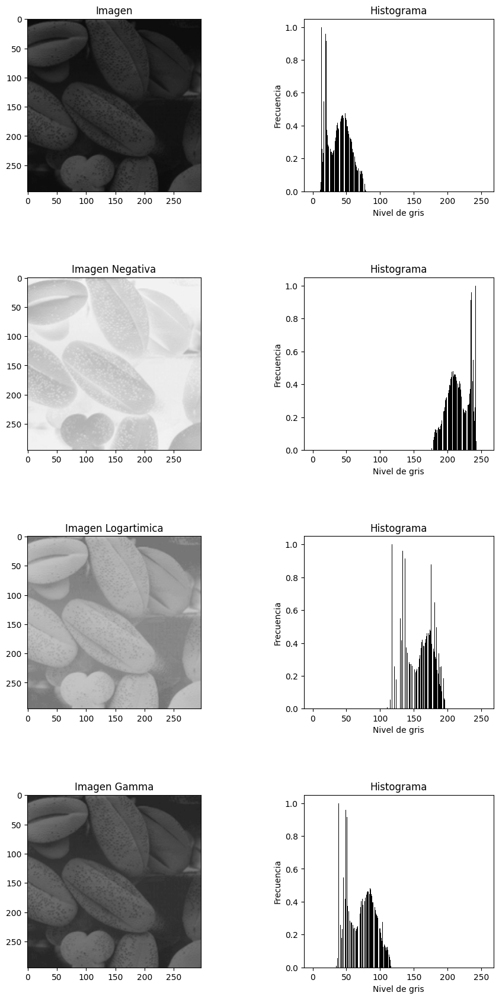

In [39]:
apply_transformations('granos.png')

In [22]:
def pdf_cdf(image) :
    #imagen = Image.open(image)
    histo = image_histograma(image)
    m,n = image.size
    total = m*n
    probabilidad = histo / (m*n)
    cdf = np.cumsum(probabilidad)*255
    pixeles = list(map(int, cdf))
    
    #imagen_ecualizada = np.interp(imagen, range(256), cdf).astype(np.uint8)
    return pixeles

In [23]:
def ecualizacion(imagen) :
  try :
   if (imagen.endswith(".jpg") or imagen.endswith(".png") or imagen.endswith(".tiff") or imagen.endswith(".tif"))  and os.path.exists(imagen):    
     image = Image.open(imagen)
     if image.mode == "L" :
            histograma = image_histograma(image)
            histograma_Eq = np.zeros(256, dtype=int)
            nuevos_valores = pdf_cdf(image)
            m,n = image.size
            image_Eq = Image.new("L", (m, n))
            #Histograma
            for x in range(m):
                    for y in range(n):
                        pixel_valor = image.getpixel((x, y))
                        valor_nuevo = nuevos_valores[pixel_valor]
                        histograma_Eq[valor_nuevo] += 1
                        image_Eq.putpixel((x, y), valor_nuevo)
                        
            plt.figure(figsize=(15, 15))
        
            plt.subplot(2, 2, 1)
            plt.imshow(image,cmap='gray', vmin=0, vmax=255)
            plt.title('Imagen')
            
            plt.subplot(2, 2, 2)
            plt.xlabel('Nivel de gris')
            plt.ylabel('Frecuencia')
            plt.bar(range(256), normalizacion_histograma(histograma),color='black')
            plt.title('Histograma')
        
            plt.subplot(2, 2, 3)
            plt.imshow(image_Eq,cmap='gray', vmin=0, vmax=255)
            plt.title('Imagen Ecualizada')
            
            plt.subplot(2, 2, 4)
            plt.xlabel('Nivel de gris')
            plt.ylabel('Frecuencia')
            plt.bar(range(256), normalizacion_histograma(histograma_Eq),color='black')
            plt.title('Histograma Ecualizado')
        
            plt.subplots_adjust(left=0.1, right=0.7, bottom=0.1, top=0.6, wspace=0.5, hspace=0.5)
     else :
        print("Se solicita una imagen en escala de grises")
   else:
        raise ValueError("La imagen no tiene la extensión .jpg|.png|.tiff|.tif o no existe el archivo")
  except ValueError as e:
          print(f"Error: {e}")

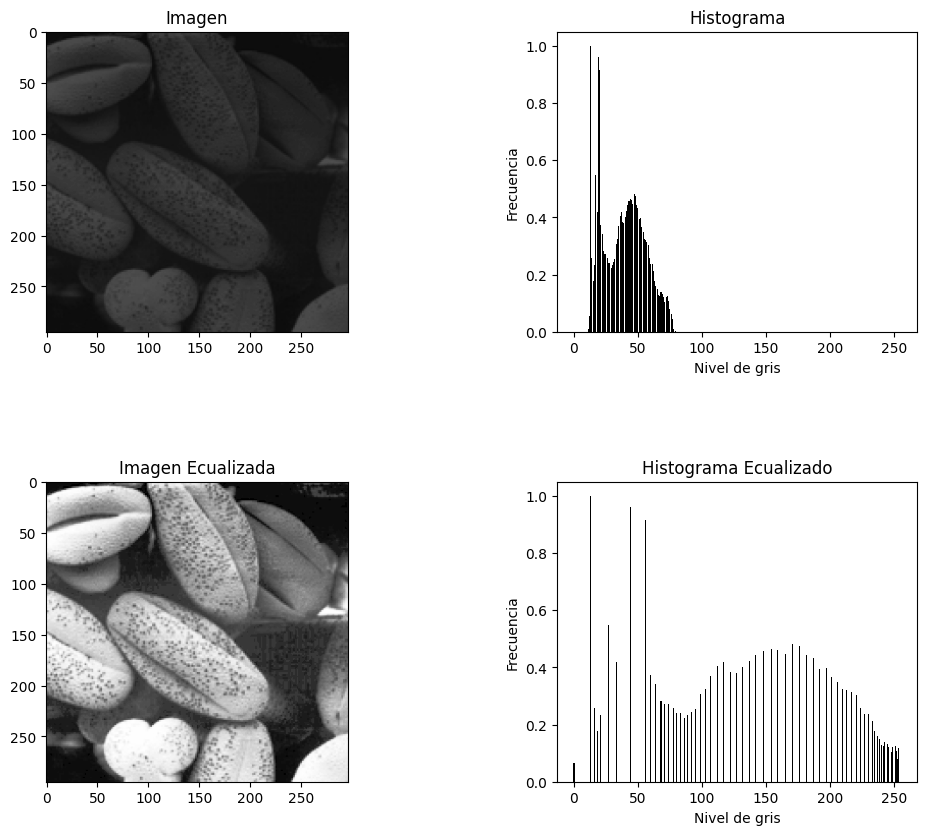

In [15]:
ecualizacion('granos.png')

## Ejercicio 2

In [15]:
def ruido_gaussiano(imagen, desviacion_estandar=10):
    # Convierte la imagen a una matriz NumPy con tipo de datos np.uint8
    imagen_np = np.array(imagen).astype(np.uint8)

    # Genera el ruido gaussiano
    ruido_gaussiano = np.random.normal(0, float(desviacion_estandar), imagen_np.shape).astype(np.uint8)

    # Suma el ruido gaussiano a la imagen
    imagen_con_ruido = np.add(imagen_np, ruido_gaussiano)

    # Convierte la matriz NumPy de nuevo a una imagen PIL
    imagen_con_ruido_pil = Image.fromarray(imagen_con_ruido)

    return imagen_con_ruido_pil

In [10]:
def ruido_Gaussiano_N(img, desviacion_e = 50) :  
        img_array = np.array(img, dtype=np.uint8)
        noise = np.random.normal(0, desviacion_e, img_array.shape)
        imagen_ruido = img_array + noise
        imagen_ruido = np.clip(imagen_ruido, 0, 255)
        imagen_ruido_pil = Image.fromarray(imagen_ruido.astype(np.uint8), 'L')
        
        return imagen_ruido_pil

In [11]:
def ruido_sal_pimienta(imagen, probabilidad_ruido=0.04):
    imagen_np = np.array(imagen)
    ruido = np.random.rand(*imagen_np.shape)
    mascara_sal = ruido < probabilidad_ruido / 2
    mascara_pimienta = ruido > 1 - probabilidad_ruido / 2
    imagen_con_ruido = np.copy(imagen_np)
    imagen_con_ruido[mascara_sal] = 0  # Sal: establece píxeles a negro
    imagen_con_ruido[mascara_pimienta] = 255  # Pimienta: establece píxeles a blanco
    imagen_con_ruido_pil = Image.fromarray(imagen_con_ruido)
    return imagen_con_ruido_pil

In [24]:
## Definir imagenes con ruido y sin ruido 
img1  = Image.open('lena.tiff')
img2  = Image.open('tungsten_2.jpg')
img3  = Image.open('tungsten_1.jpg')

In [25]:
img_ruidoG1 = ruido_Gaussiano_N(img1)
img_ruidoG2 = ruido_Gaussiano_N(img2)
img_ruidoG3 = ruido_Gaussiano_N(img3)

In [26]:
img_ruidoSP1 = ruido_sal_pimienta(img1)
img_ruidoSP2 = ruido_sal_pimienta(img2)
img_ruidoSP3 = ruido_sal_pimienta(img3)

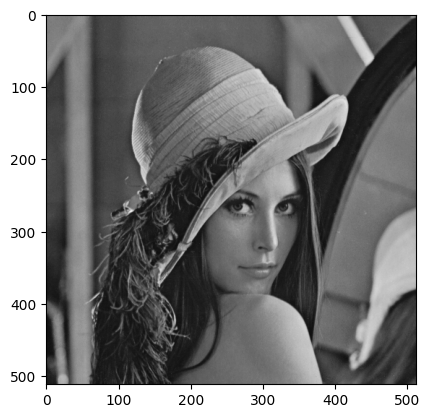

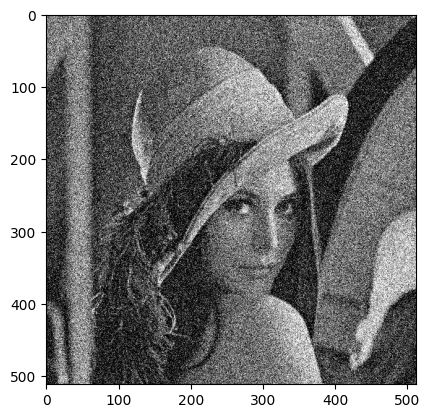

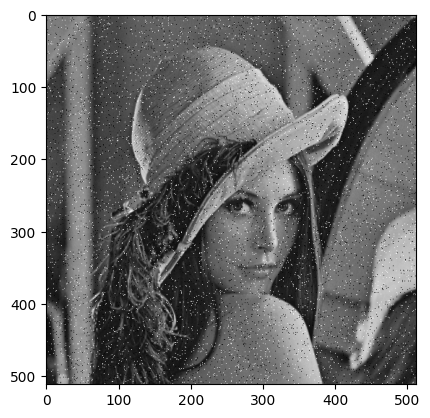

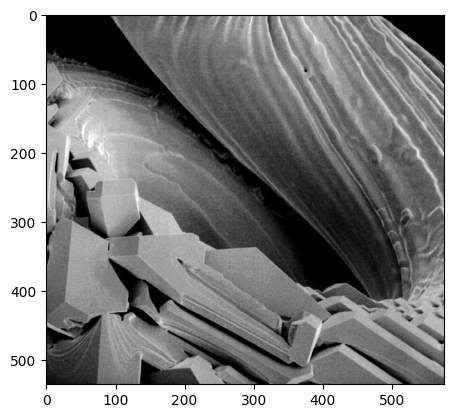

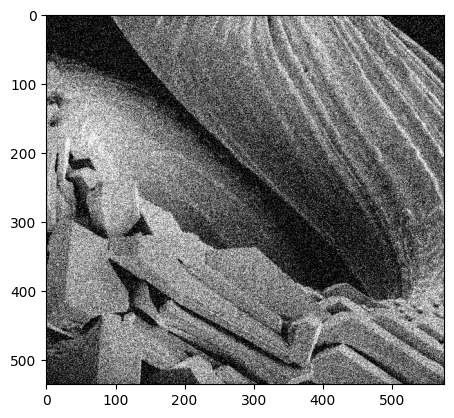

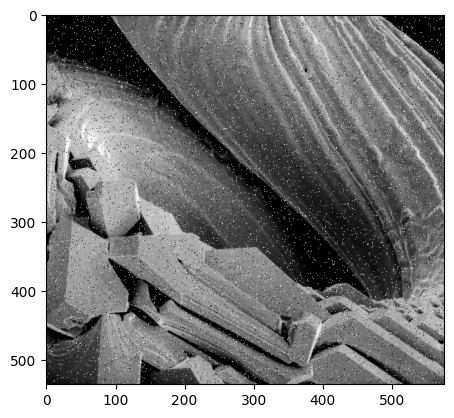

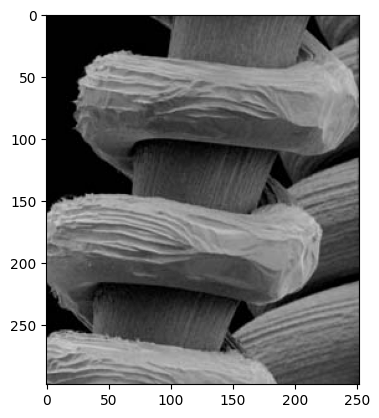

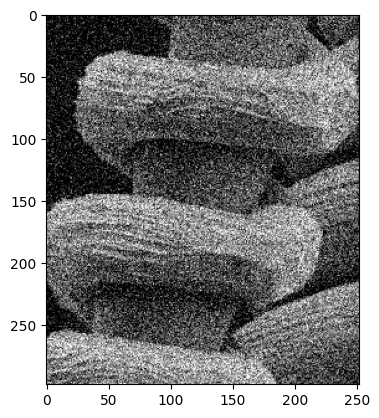

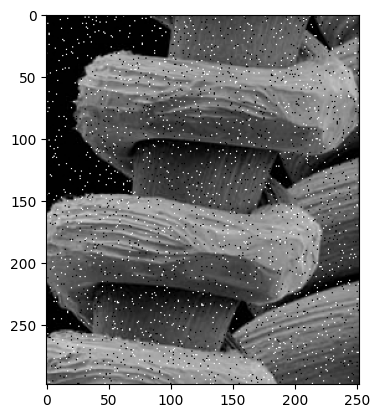

In [96]:
show_image(img1)
show_image(img_ruidoG1)
show_image(img_ruidoSP1)

show_image(img2)
show_image(img_ruidoG2)
show_image(img_ruidoSP2)

show_image(img3)
show_image(img_ruidoG3)
show_image(img_ruidoSP3)


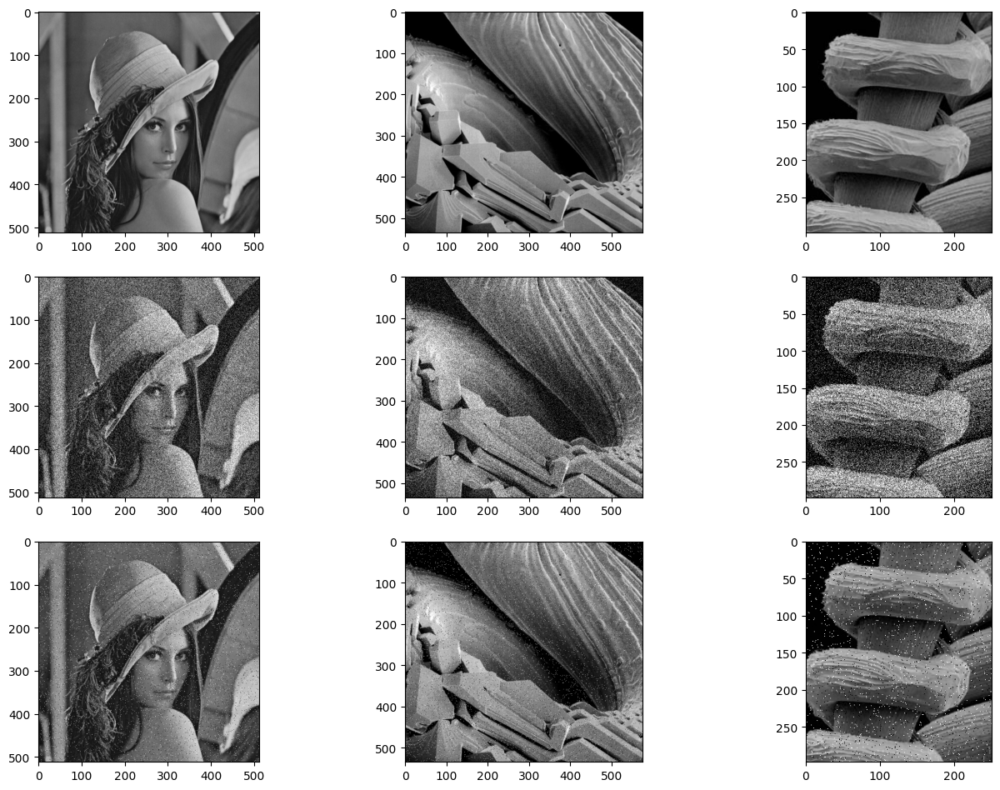

In [15]:
plt.figure(figsize=(30, 30)) 

plt.subplot(3, 3, 1)
plt.imshow(img1,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Lenna')

plt.subplot(3, 3, 2)
plt.imshow(img2,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Tungsteno 2')

plt.subplot(3, 3, 3)
plt.imshow(img3,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Tungsteno 1')

plt.subplot(3, 3, 4)
plt.imshow(img_ruidoG1,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Lenna RG')

plt.subplot(3, 3, 5)
plt.imshow(img_ruidoG2,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Tungsteno 2 RG')

plt.subplot(3, 3, 6)
plt.imshow(img_ruidoG3,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Tungsteno 1 RG')

plt.subplot(3, 3, 7)
plt.imshow(img_ruidoSP1,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Lenna S&P')

plt.subplot(3, 3, 8)
plt.imshow(img_ruidoSP2,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Tungsteno  2 S&P')
 
plt.subplot(3, 3, 9)
plt.imshow(img_ruidoSP3,cmap='gray', vmin=0, vmax=255)
#plt.title('Imagen Tungsteno  1 S&P')

plt.subplots_adjust(left=0.1, right=0.5, bottom=0.1, top=0.4, wspace=0.5, hspace=0.2)

### Funciones Auxiliares

In [27]:
def vecindad_3x3(x,y) :
           #pixeles_adj = cuatro_adyacencias(x,y)
           pixeles_adj = []
           pixeles_adj.append((x - 1, y-1))
           pixeles_adj.append((x, y - 1))
           pixeles_adj.append((x + 1, y-1))
           pixeles_adj.append((x - 1, y))
           pixeles_adj.append((x, y))
           pixeles_adj.append((x + 1, y))
           pixeles_adj.append((x - 1, y + 1))
           pixeles_adj.append((x, y + 1))
           pixeles_adj.append((x + 1 , y + 1))
           return pixeles_adj

In [17]:
def vecindad_5x5(x, y):
    coordenadas = []
    for i in range(x - 2, x + 3):
        for j in range(y - 2, y + 3):
            coordenadas.append((i, j))
    
    return coordenadas

In [18]:
def vecindad_7x7(x, y):
    pixeles_adj = []
    for i in range(x - 3, x + 4):
        for j in range(y - 3, y + 4):
            pixeles_adj.append((i, j))
    return pixeles_adj

In [19]:
def vecindad_11x11(x, y):
    pixeles_adj = []
    for i in range(x - 5, x + 6):
        for j in range(y - 5, y + 6):
            pixeles_adj.append((i, j))
    return pixeles_adj

In [19]:
def resta_orden(orden) :
    resta = 0
    if orden == 3 :
        resta = 2
    if orden == 5 :
        resta = 4
    if orden == 7 :
        resta = 6
    if orden == 11 :
        resta = 10
    return resta

In [20]:
def suma_orden(orden) :
    suma = 0
    if orden == 3 :
        suma = 1
    if orden == 5 :
        suma = 2
    if orden == 7 :
       suma = 3
    if orden == 11 :
       suma = 5
    return suma

In [28]:
def vecinos_nxn(x,y,orden) :
    vecinos = []
    if orden == 3 :
        vecinos = vecindad_3x3(x,y)
    if orden == 5 :
        vecinos = vecindad_5x5(x,y)
    if orden == 7 :
        vecinos = vecindad_7x7(x,y)
    if orden == 11 :
        vecinos = vecindad_11x11(x,y)
    return vecinos

In [29]:
def show_comparacion_filtros(texto,img,img3x3,img5x5,img7x7,img11x11) :
    plt.figure(figsize=(30, 30))  # Ajusta el tamaño según tus necesidades

    plt.subplot(2, 3, 1)
    plt.imshow(img,cmap='gray', vmin=0, vmax=255)
    plt.title(texto)
    
    plt.subplot(2, 3, 2)
    plt.imshow(img3x3,cmap='gray', vmin=0, vmax=255)
    plt.title('3x3')
    
    plt.subplot(2, 3, 3)
    plt.imshow(img5x5,cmap='gray', vmin=0, vmax=255)
    plt.title('5x5')
    
    plt.subplot(2, 3, 4)
    plt.imshow(img7x7,cmap='gray', vmin=0, vmax=255)
    plt.title('7x7')
    
    plt.subplot(2, 3, 5)
    plt.imshow(img11x11,cmap='gray', vmin=0, vmax=255)
    plt.title('11x11')
    
    plt.subplots_adjust(left=0.1, right=0.5, bottom=0.1, top=0.4, wspace=0.5, hspace=0.1)

In [31]:
def show_comparacion_filtros_2(img,img3x3,img5x5,img7x7,img11x11,img2,img23x3,img25x5,img27x7,img211x11) :
    plt.figure(figsize=(30, 30))  

    plt.subplot(5, 2, 1)
    plt.imshow(img,cmap='gray', vmin=0, vmax=255)
    plt.title('Imagen RG')
    
    plt.subplot(5, 2, 2)
    plt.imshow(img2,cmap='gray', vmin=0, vmax=255)
    plt.title('Imagen RS&P')
    
    plt.subplot(5, 2, 3)
    plt.imshow(img3x3,cmap='gray', vmin=0, vmax=255)
    plt.title('3x3')
    
    plt.subplot(5, 2, 4)
    plt.imshow(img23x3,cmap='gray', vmin=0, vmax=255)
    plt.title('3x3')

    plt.subplot(5, 2, 5)
    plt.imshow(img5x5,cmap='gray', vmin=0, vmax=255)
    plt.title('5x5')
    
    plt.subplot(5, 2, 6)
    plt.imshow(img25x5,cmap='gray', vmin=0, vmax=255)
    plt.title('5x5')

    plt.subplot(5, 2, 7)
    plt.imshow(img7x7,cmap='gray', vmin=0, vmax=255)
    plt.title('7x7')
    
    plt.subplot(5, 2, 8)
    plt.imshow(img27x7,cmap='gray', vmin=0, vmax=255)
    plt.title('7x7')

    plt.subplot(5, 2, 9)
    plt.imshow(img11x11,cmap='gray', vmin=0, vmax=255)
    plt.title('7x7')
    
    plt.subplot(5, 2, 10)
    plt.imshow(img211x11,cmap='gray', vmin=0, vmax=255)
    plt.title('7x7')
    
    
    
    plt.subplots_adjust(left=0.1, right=0.4, bottom=0.1, top=0.9, wspace=0.1, hspace=0.3)

In [32]:
def show_comparacion_filtros_3_1(texto,texto2,texto3,texto4,texto5,texto6,texto7,texto8,texto9,texto10,texto11,texto12,
                                 img,img2,img3,img4,img5,img6,img7,img8,img9,img10,img11,img12) :
    plt.figure(figsize=(30, 30))  

    plt.subplot(4, 3, 1)
    plt.imshow(img,cmap='gray', vmin=0, vmax=255)
    plt.title(texto)
    
    plt.subplot(4, 3, 2)
    plt.imshow(img2,cmap='gray', vmin=0, vmax=255)
    plt.title(texto2)
    
    plt.subplot(4, 3, 3)
    plt.imshow(img3,cmap='gray', vmin=0, vmax=255)
    plt.title(texto3)
    
    plt.subplot(4, 3, 4)
    plt.imshow(img4,cmap='gray', vmin=0, vmax=255)
    plt.title(texto4)
    
    plt.subplot(4, 3, 5)
    plt.imshow(img5,cmap='gray', vmin=0, vmax=255)
    plt.title(texto5)

    plt.subplot(4, 3, 6)
    plt.imshow(img6,cmap='gray', vmin=0, vmax=255)
    plt.title(texto6)

    plt.subplot(4, 3, 7)
    plt.imshow(img7,cmap='gray', vmin=0, vmax=255)
    plt.title(texto7)

    plt.subplot(4, 3, 8)
    plt.imshow(img8,cmap='gray', vmin=0, vmax=255)
    plt.title(texto8)

    plt.subplot(4, 3, 9)
    plt.imshow(img9,cmap='gray', vmin=0, vmax=255)
    plt.title(texto9)

    plt.subplot(4, 3, 10)
    plt.imshow(img10,cmap='gray', vmin=0, vmax=255)
    plt.title(texto10)

    plt.subplot(4, 3, 11)
    plt.imshow(img11,cmap='gray', vmin=0, vmax=255)
    plt.title(texto11)

    plt.subplot(4, 3, 12)
    plt.imshow(img12,cmap='gray', vmin=0, vmax=255)
    plt.title(texto12)
    
    plt.subplots_adjust(left=0.1, right=0.5, bottom=0.1, top=0.6, wspace=0.5, hspace=0.2)

In [33]:
def show_comparacion_filtros_3(texto,texto2,texto3,texto4,img,img2,img3,img4) :
    plt.figure(figsize=(30, 30))  # Ajusta el tamaño según tus necesidades

    plt.subplot(2, 3, 1)
    plt.imshow(img,cmap='gray', vmin=0, vmax=255)
    plt.title(texto)
    
    plt.subplot(2, 3, 2)
    plt.imshow(img2,cmap='gray', vmin=0, vmax=255)
    plt.title(texto2)
    
    plt.subplot(2, 3, 3)
    plt.imshow(img3,cmap='gray', vmin=0, vmax=255)
    plt.title(texto3)
    
    plt.subplot(2, 3, 4)
    plt.imshow(img4,cmap='gray', vmin=0, vmax=255)
    plt.title(texto4)
    
    plt.subplots_adjust(left=0.1, right=0.5, bottom=0.1, top=0.38, wspace=0.5, hspace=0.1)

In [38]:
def show_comparacion_filtros_4(texto,texto2,texto3,img,img2,img3) :
    plt.figure(figsize=(30, 30))  # Ajusta el tamaño según tus necesidades

    plt.subplot(1, 3, 1)
    plt.imshow(img,cmap='gray', vmin=0, vmax=255)
    plt.title(texto)
    
    plt.subplot(1, 3, 2)
    plt.imshow(img2,cmap='gray', vmin=0, vmax=255)
    plt.title(texto2)
    
    plt.subplot(1, 3, 3)
    plt.imshow(img3,cmap='gray', vmin=0, vmax=255)
    plt.title(texto3)
    
    plt.subplots_adjust(left=0.1, right=0.5, bottom=0.1, top=0.38, wspace=0.5, hspace=0.1)

In [37]:
def show_comparacion_filtros_5(texto,texto2,texto3,texto4,img,img2,img3,img4) :
    plt.figure(figsize=(30, 30))  # Ajusta el tamaño según tus necesidades

    plt.subplot(2, 3, 1)
    plt.imshow(img,cmap='gray', vmin=0, vmax=255)
    plt.title(texto)
    
    plt.subplot(2, 3, 2)
    plt.imshow(img2,cmap='gray', vmin=0, vmax=255)
    plt.title(texto2)
    
    plt.subplot(2, 3, 3)
    plt.imshow(img3,cmap='gray', vmin=0, vmax=255)
    plt.title(texto3)

    plt.subplot(2, 3, 3)
    plt.imshow(img4,cmap='gray', vmin=0, vmax=255)
    plt.title(texto4)
    
    plt.subplots_adjust(left=0.1, right=0.5, bottom=0.1, top=0.4, wspace=0.5, hspace=0.1)

In [24]:
def suma_imagenes(img,img2) :
    ancho, alto = img2.size
    img_re = img.resize((ancho, alto))
    imageN = Image.new("L", (ancho, alto))
    for x in range(ancho) :
     for y in range (alto) :
        valor1 = img_re.getpixel((x,y))
        valor2 = img2.getpixel((x,y))
        valorSum = valor1 + valor2
        valorSum = max(0, min(valorSum, 255))
        imageN.putpixel((x, y), valorSum)
    return imageN

In [25]:
def resta_imagenes(img,img2) :
    ancho, alto = img2.size
    img_re = img.resize((ancho, alto))
    imageN = Image.new("L", (ancho, alto))
    for x in range(ancho) :
     for y in range (alto) :
        valor1 = img_re.getpixel((x,y))
        valor2 = img2.getpixel((x,y))
        valorRes = valor1 - valor2
        valorRes2 = (valorRes + 255) // 2
        imageN.putpixel((x, y), valorRes2)
    return imageN

In [26]:
def resta_imagenes_2(img,img2) :
    ancho, alto = img2.size
    img_re = img.resize((ancho, alto))
    imageN = Image.new("L", (ancho, alto))
    min = 0 
    max = 0
    for x in range(ancho) :
     for y in range (alto) :
        valor1 = img_re.getpixel((x,y))
        valor2 = img2.getpixel((x,y))
        valorRes = valor1 - valor2
        if valorRes < min :
            min = valorRes
        #valorRes2 = (valorRes + 255) // 2
        imageN.putpixel((x, y), valorRes)
    rango = max - min
    for x in range(ancho) :
      for y in range (alto) :
        valor_pixel = imageN.getpixel((x,y))
        if valor_pixel < 0 :
            nuevo_valor =  valor_pixel * (min)
            imageN.putpixel((x, y), nuevo_valor)
        elif valor_pixel > 255 :
            nuevo_valor = 255
            imageN.putpixel((x, y), nuevo_valor)
        #valorRes2 = (valorRes + 255) // 2
        else :
            imageN.putpixel((x, y), valor_pixel)
    
    return imageN

### Filtro paso-bajas promedio estandar

In [34]:
def convolucion_promedio_estandar(n,vecindades,image) :
    suma = 0
    for v in vecindades :
        pixel = image.getpixel(v) // n
        pixel = pixel * 1
        suma = suma + pixel
    return suma

In [35]:
def filtro_pbp_estandar(orden,image):
 ordenes_Disponibles = [3,5,7,11]
 try :    
  if isinstance(image, Image.Image):
    if image.mode == "L"  and (orden in ordenes_Disponibles):
        n = orden * orden
        ancho, alto = image.size
        resta = resta_orden(orden)
        anchoN = ancho-resta
        altoN = alto-resta
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            x_Aux = x
            y_Aux = y
            suma = suma_orden(orden)
            original_x = x_Aux + suma
            original_y = y_Aux + suma
            vecinos = vecinos_nxn(original_x,original_y,orden)
            suma = convolucion_promedio_estandar(n,vecinos,image)
            imageN.putpixel((x, y), suma)
        return imageN
    else :
        print("Se solicita una imagen en escala de grises")  
        print("Se solicita un orden válido entre [3,5,7,11]")
        print("Se solicita un imagen de objeto PIL")
  else :
        raise ValueError("Se solicita un imagen de objeto tipo PIL") 
 except ValueError as e:
          print(f"Error: {e}")

In [37]:
## Imagen Original#
img_pbp_estandar_1 = filtro_pbp_estandar(3,img3)
#show_image(img_pbp_estandar_1)
img_pbp_estandar_2 = filtro_pbp_estandar(5,img3)
#show_image(img_pbp_estandar_2)
img_pbp_estandar_3 = filtro_pbp_estandar(7,img3)
#show_image(img_pbp_estandar_3)
img_pbp_estandar_4 = filtro_pbp_estandar(11,img3)
#show_image(img_pbp_estandar_4)

In [90]:
#Imagen con rudio gaussiano 
img_pbp_estandar_5 = filtro_pbp_estandar(3,img_ruidoG3)
#show_image(img_pbp_estandar_5)
img_pbp_estandar_6 = filtro_pbp_estandar(5,img_ruidoG3)
#show_image(img_pbp_estandar_6)
img_pbp_estandar_7 = filtro_pbp_estandar(7,img_ruidoG3)
#show_image(img_pbp_estandar_7)
img_pbp_estandar_8 = filtro_pbp_estandar(11,img_ruidoG3)
#show_image(img_pbp_estandar_8)

In [89]:
#Imagen con rudio S&P
img_pbp_estandar_9 = filtro_pbp_estandar(3,img_ruidoSP3)
#show_image(img_pbp_estandar_9)
img_pbp_estandar_10 = filtro_pbp_estandar(5,img_ruidoSP3)
#show_image(img_pbp_estandar_10)
img_pbp_estandar_11 = filtro_pbp_estandar(7,img_ruidoSP3)
#show_image(img_pbp_estandar_11)
img_pbp_estandar_12 = filtro_pbp_estandar(11,img_ruidoSP3)
#how_image(img_pbp_estandar_12)

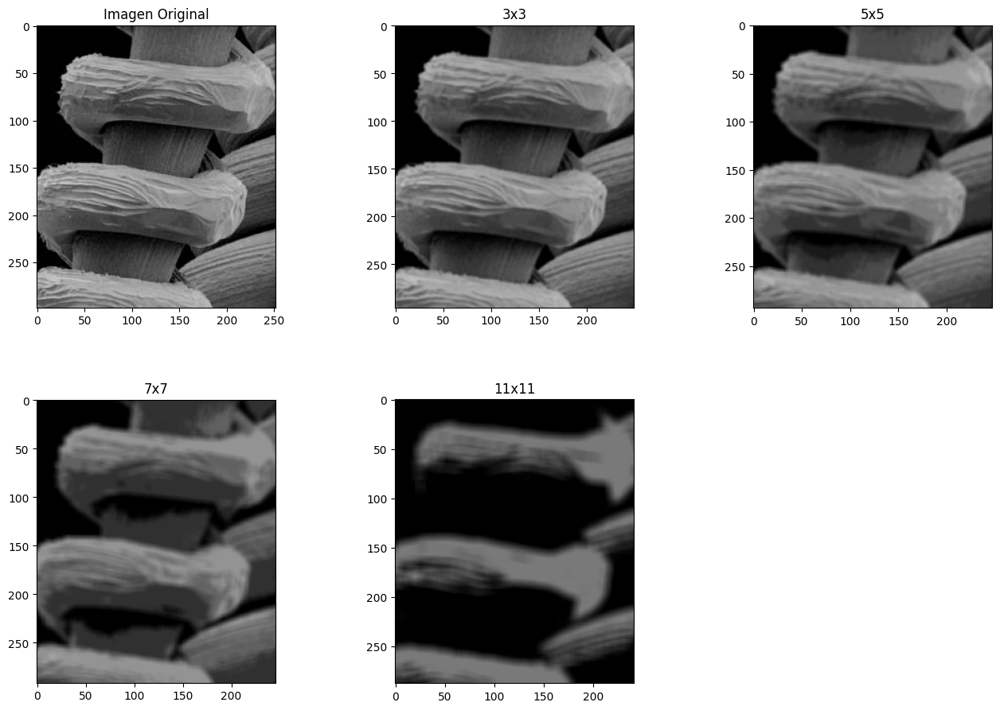

In [38]:
show_comparacion_filtros('Imagen Original',img3,img_pbp_estandar_1,img_pbp_estandar_2,img_pbp_estandar_3,
                         img_pbp_estandar_4) 

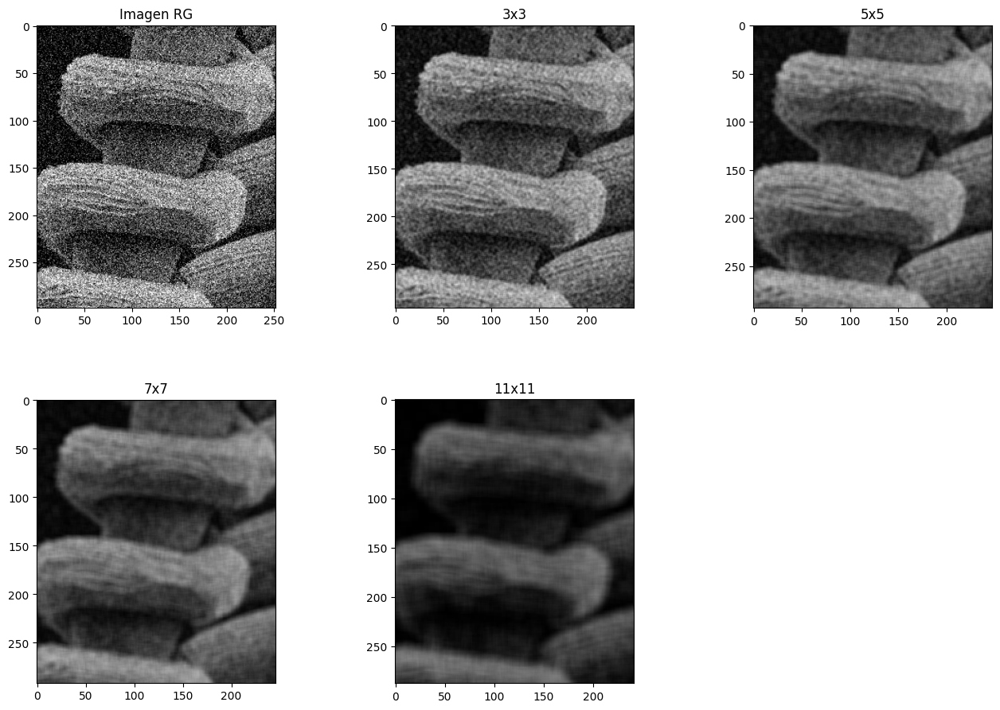

In [91]:
show_comparacion_filtros('Imagen RG',img_ruidoG3,img_pbp_estandar_5,img_pbp_estandar_6,img_pbp_estandar_7,
                         img_pbp_estandar_8) 

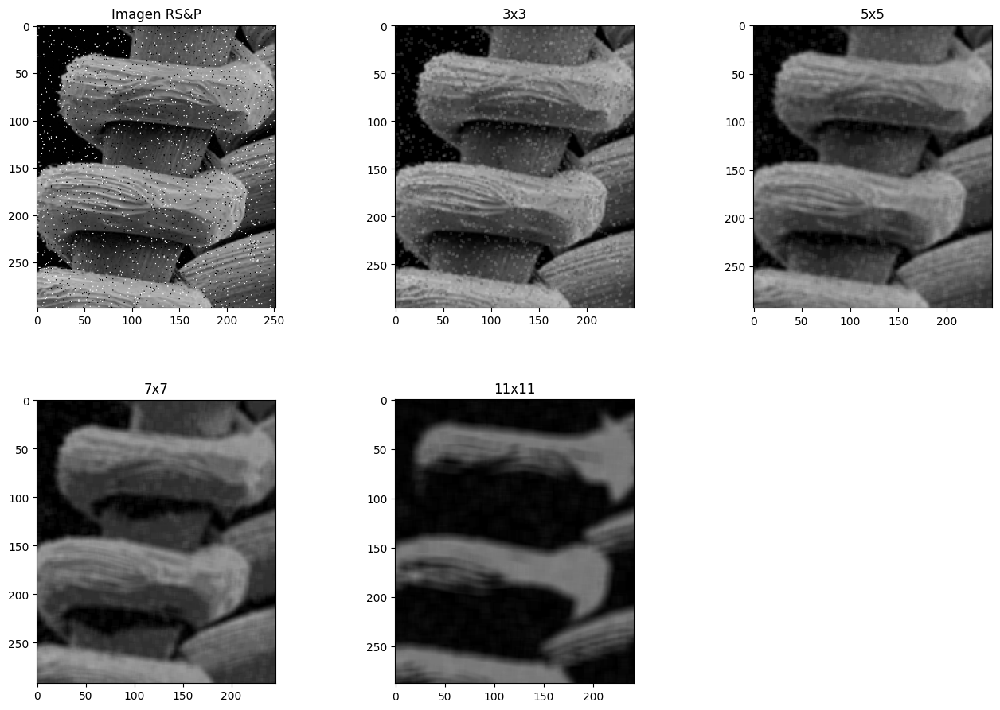

In [92]:
show_comparacion_filtros('Imagen RS&P',img_ruidoSP3,img_pbp_estandar_9,img_pbp_estandar_10,img_pbp_estandar_11,
                         img_pbp_estandar_12) 

## Filtro paso-bajas promedio ponderado

In [36]:
def generate_pascal_triangle_row(n):
    pascal_triangle = np.zeros((n, n), dtype=int)
    for line in range(n):
        for i in range(line + 1):
            if i == 0 or i == line:
                pascal_triangle[line][i] = 1
            else:
                pascal_triangle[line][i] = pascal_triangle[line - 1][i - 1] + pascal_triangle[line - 1][i]
    return pascal_triangle[n-1]

In [37]:
def kernel_nxn(n):
    row_triangle = generate_pascal_triangle_row(n).reshape(n,1) # parada
    column_triangle = row_triangle.reshape(1,n) #acostada
    #matrizA = np.tile(column_triangle, (n, 1))
    matrizB = row_triangle * column_triangle
    #matrizB = factor1 * factor2
    return matrizB

In [39]:
def constante_kernel_nxn(n) :
    row_triangle = generate_pascal_triangle_row(n).reshape(n,1) # parada
    k = np.sum(row_triangle)
    constante = k * k
    return constante

In [40]:
def convolucion_promedio_ponderado(image,orden,vecinos,k,kernel) :
    i = 0
    suma = 0
    for x in range(0,orden) :
        for y in range(0,orden) :
            valor = kernel[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = (valor * valor2) // k
            suma = suma + pixel_valor
    #resultado = round(suma/k)
    return round(suma)

In [41]:
def filtro_pbp_ponderado(orden,image):
 ordenes_Disponibles = [3,5,7,11]
 try :   
    if isinstance(image, Image.Image):
      if image.mode == "L"  and (orden in ordenes_Disponibles):
        ancho, alto = image.size
        resta = resta_orden(orden)
        anchoN = ancho - resta
        altoN = alto- resta
        kernel = kernel_nxn(orden)
        k = constante_kernel_nxn(orden) 
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            x_Aux = x
            y_Aux = y
            suma = suma_orden(orden)
            original_x = x_Aux + suma
            original_y = y_Aux + suma
            #vecinos = vecindades(original_x,original_y)
            #vecinos = vecindad_5x5(original_x,original_y)
            vecinos = vecinos_nxn(original_x,original_y,orden)
            suma = convolucion_promedio_ponderado(image,orden,vecinos,k,kernel)
            imageN.putpixel((x, y), suma)
        return imageN
      else :
            print("Se solicita una imagen en escala de grises")  
            print("Se solicita un orden válido entre [3,5,7,11]")
            print("Se solicita un imagen de objeto tipo PIL")
    else :
        raise ValueError("Se solicita un imagen de objeto tipo PIL")
 except ValueError as e:
          print(f"Error: {e}")

In [56]:
#filtro_pbp_ponderado(3,img3)

In [49]:
## Imagen Original
img_pbp_ponderado_1 = filtro_pbp_ponderado(3,img3)
#show_image(img_pbp_ponderado_1)
img_pbp_ponderado_2 = filtro_pbp_ponderado(5,img3)
#show_image(img_pbp_ponderado_2)
img_pbp_ponderado_3 = filtro_pbp_ponderado(7,img3)
#show_image(img_pbp_ponderado_3)
img_pbp_ponderado_4 = filtro_pbp_ponderado(11,img3)
#show_image(img_pbp_ponderado_4)

In [ ]:
#Imagen con rudio gaussiano #
img_pbp_ponderado_5 = filtro_pbp_ponderado(3,img_ruidoG3)
#show_image(img_pbp_ponderado_5)
img_pbp_ponderado_6 = filtro_pbp_ponderado(5,img_ruidoG3)
#show_image(img_pbp_ponderado_6)
img_pbp_ponderado_7 = filtro_pbp_ponderado(7,img_ruidoG3)
#show_image(img_pbp_ponderado_7)
img_pbp_ponderado_8 = filtro_pbp_ponderado(11,img_ruidoG3)
#show_image(img_pbp_ponderado_8)

In [92]:
#Imagen con rudio S&P
img_pbp_ponderado_9 = filtro_pbp_ponderado(3,img_ruidoSP3)
#show_image(img_pbp_ponderado_9)
img_pbp_ponderado_10 = filtro_pbp_ponderado(5,img_ruidoSP3)
#show_image(img_pbp_ponderado_10)
img_pbp_ponderado_11 = filtro_pbp_ponderado(7,img_ruidoSP3)
#show_image(img_pbp_ponderado_11)
img_pbp_ponderado_12 = filtro_pbp_ponderado(11,img_ruidoSP3)
#how_image(img_pbp_ponderado_12)

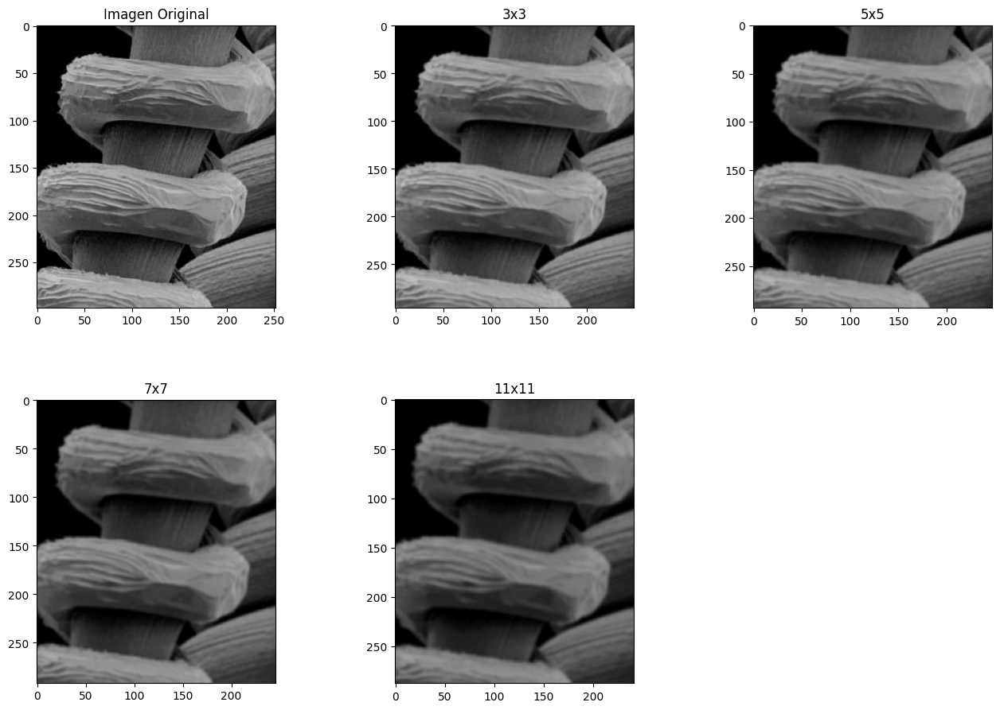

In [53]:
show_comparacion_filtros('Imagen Original',img3,img_pbp_ponderado_1,img_pbp_ponderado_2,img_pbp_ponderado_3,
                         img_pbp_ponderado_4) 

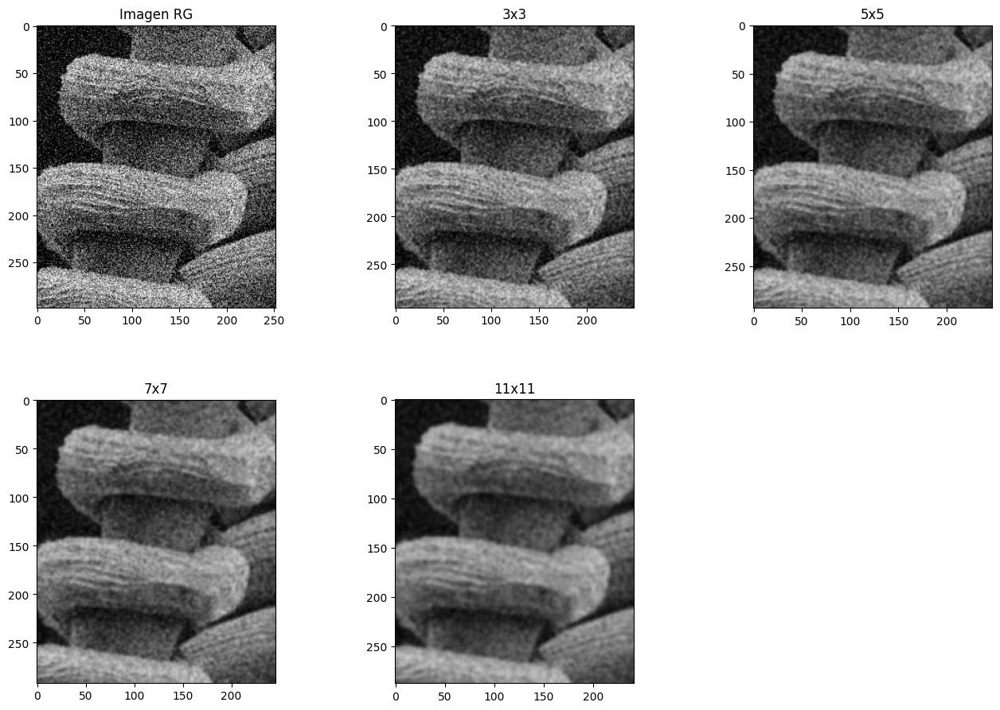

In [94]:
show_comparacion_filtros('Imagen RG',img_ruidoG3,img_pbp_ponderado_5,img_pbp_ponderado_6,img_pbp_ponderado_7,
                         img_pbp_ponderado_8) 

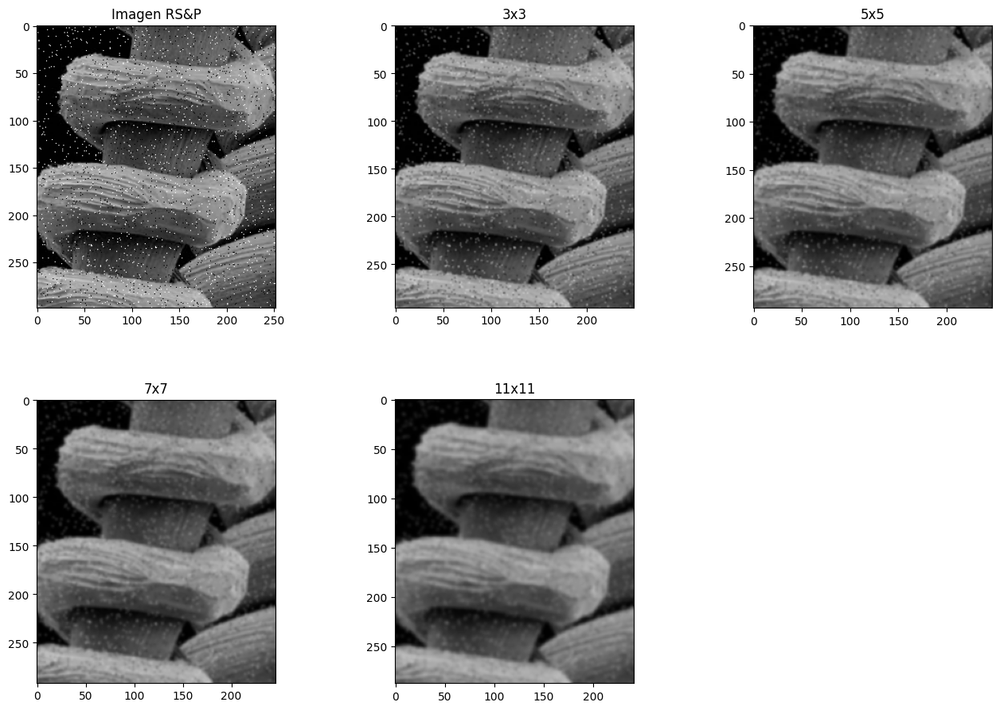

In [95]:
show_comparacion_filtros('Imagen RS&P',img_ruidoSP3,img_pbp_ponderado_9,img_pbp_ponderado_10,img_pbp_ponderado_11,
                         img_pbp_ponderado_12) 

## Filtro paso-bajas (No lineal) Mediana

In [42]:
def convolucion_mediana(vecindades,image) :
    pixeles = []
    for v in vecindades :
        pixel = image.getpixel(v)
        pixel = pixel * 1
        pixeles.append(pixel)
    mediana = mediana_pixeles (pixeles)
    return mediana

In [43]:
def mediana_pixeles (pixeles):
    
        lista_ordenada = sorted(pixeles)
        n = len(lista_ordenada)
        if n % 2 == 0:
            medio_izquierdo = lista_ordenada[n // 2 - 1]
            medio_derecho = lista_ordenada[n // 2]
            mediana = (medio_izquierdo + medio_derecho) / 2
        else:
            mediana = lista_ordenada[n // 2]
        
        return mediana

In [44]:
def filtro_pbp_mediana(orden,image) :
 ordenes_Disponibles = [3,5,7,11]
 try :    
   if isinstance(image, Image.Image): 
      if image.mode == "L"  and (orden in ordenes_Disponibles):
        ancho, alto = image.size
        resta = resta_orden(orden)
        anchoN = ancho-resta
        altoN = alto-resta
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            x_Aux = x
            y_Aux = y
            suma = suma_orden(orden)
            original_x = x_Aux + suma
            original_y = y_Aux + suma
            #vecinos = vecindades(original_x,original_y)
            vecinos = vecinos_nxn(original_x,original_y,orden)
            mediana = convolucion_mediana(vecinos,image)
            medianaN = int(mediana)
            imageN.putpixel((x, y), medianaN)
        return imageN
      else :
            print("Se solicita una imagen en escala de grises")  
            print("Se solicita un orden válido entre [3,5,7,11]")
            print("Se solicita un imagen de objeto tipo PIL")
   else :
        raise ValueError("Se solicita un imagen de objeto tipo PIL") 
 except ValueError as e:
          print(f"Error: {e}")

In [106]:
#Imagen con rudio gaussiano 
img_pbp_mediana_1 = filtro_pbp_mediana(3,img_ruidoG3)
#show_image(img_pbp_mediana_1)
img_pbp_mediana_2 = filtro_pbp_mediana(5,img_ruidoG3)
#show_image(img_pbp_mediana_2)
img_pbp_mediana_3 = filtro_pbp_mediana(7,img_ruidoG3)
#show_image(img_pbp_mediana_3)
img_pbp_mediana_4 = filtro_pbp_mediana(11,img_ruidoG3)
#show_image(img_pbp_mediana_4)

In [107]:
#Imagen con rudio S&P
img_pbp_mediana_5 = filtro_pbp_mediana(3,img_ruidoSP3)
#show_image(img_pbp_mediana_5)
img_pbp_mediana_6 = filtro_pbp_mediana(5,img_ruidoSP3)
#show_image(img_pbp_mediana_6)
img_pbp_mediana_7 = filtro_pbp_mediana(7,img_ruidoSP3)
#show_image(img_pbp_mediana_7)
img_pbp_mediana_8 = filtro_pbp_mediana(11,img_ruidoSP3)
#how_image(img_pbp_mediana_8)

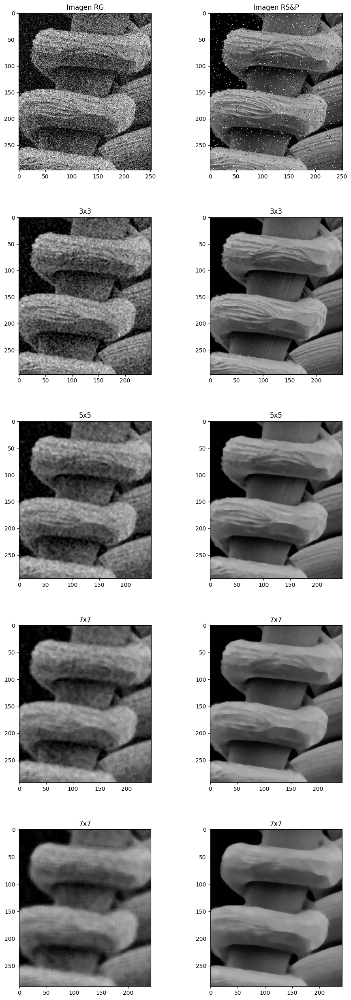

In [108]:
show_comparacion_filtros_2(img_ruidoG3,img_pbp_mediana_1,img_pbp_mediana_2,img_pbp_mediana_3,img_pbp_mediana_4,
                          img_ruidoSP3,img_pbp_mediana_5,img_pbp_mediana_6,img_pbp_mediana_7,img_pbp_mediana_8)

## Filtro paso-altas Sobel

In [45]:
def sobel_x_convolucion(vecinos,image) :
    kernel_horizontal = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_horizontal[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [46]:
def sobel_y_convolucion(vecinos,image) :
    kernel_vertical = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_vertical[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [47]:
def sobel_x_y(image,direccion) :
 direcciones_Disponibles = ['x','y']
 try :    
    if  isinstance(image, Image.Image) :
      if image.mode == "L"  and (direccion in direcciones_Disponibles) and isinstance(image, Image.Image):
        ancho, alto = image.size
        anchoN = ancho-2
        altoN = alto-2
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            x_Aux = x
            y_Aux = y
            original_x = x_Aux + 1
            original_y = y_Aux + 1
            vecinos = vecindad_3x3(original_x,original_y)
            if direccion == 'x' :
              suma = sobel_x_convolucion(vecinos,image)
            elif direccion == 'y' :
               suma = sobel_y_convolucion(vecinos,image) 
            #suma2 = prewitt_y_convolucion(vecinos,image)
            #magnitud = abs(suma) + abs(suma2)
            #magnitud = np.sqrt(suma**2 + suma2**2).astype(np.uint8)
            imageN.putpixel((x, y), int(suma))
        return imageN
      else :
            print("Se solicita una imagen en escala de grises")  
            print("Se solicita direcciones del tipo x o y")
    else :
      raise ValueError("Se solicita un imagen de objeto tipo PIL")
 except ValueError as e:
          print(f"Error: {e}")

In [48]:
def sobel(image) :
 try :   
    if  isinstance(image, Image.Image) :
     if image.mode == "L":
            ancho, alto = image.size
            anchoN = ancho-2
            altoN = alto-2
            imageN = Image.new("L", (anchoN, altoN))
            for x in range(anchoN) :
             for y in range (altoN) :
                x_Aux = x
                y_Aux = y
                original_x = x_Aux + 1
                original_y = y_Aux + 1
                vecinos = vecindad_3x3(original_x,original_y)
                suma = sobel_x_convolucion(vecinos,image)
                suma2 = sobel_y_convolucion(vecinos,image)
                #magnitud = np.sqrt(suma**2 + suma2**2).astype(np.uint8)
                magnitud = abs(suma) + abs(suma2)
                imageN.putpixel((x, y), int(magnitud))
            return imageN
     else :
            print("Se solicita una imagen en escala de grises") 
    else :
      raise ValueError("Se solicita un imagen de objeto tipo PIL")
 except ValueError as e:
          print(f"Error: {e}")

In [131]:
## Imagen Original
img_sobel_1 = sobel_x_y(img2,'x')
img_sobel_2 = sobel_x_y(img2,'y')
img_sobel_3 = sobel(img2)
img_sobel_4 = suma_imagenes(img2,img_sobel_3)

In [ ]:
## Imagen RG
img_sobel_5 = sobel_x_y(img_ruidoG2,'x')
img_sobel_6 = sobel_x_y(img_ruidoG2,'y')
img_sobel_7 = sobel(img_ruidoG2)
img_sobel_8 = suma_imagenes(img_ruidoG2,img_sobel_7)

In [102]:
## Imagen RS&P
img_sobel_9 = sobel_x_y(img_ruidoSP2,'x')
img_sobel_10 = sobel_x_y(img_ruidoSP2,'y')
img_sobel_11 = sobel(img_ruidoSP2)
img_sobel_12 = suma_imagenes(img_ruidoSP2,img_sobel_11)

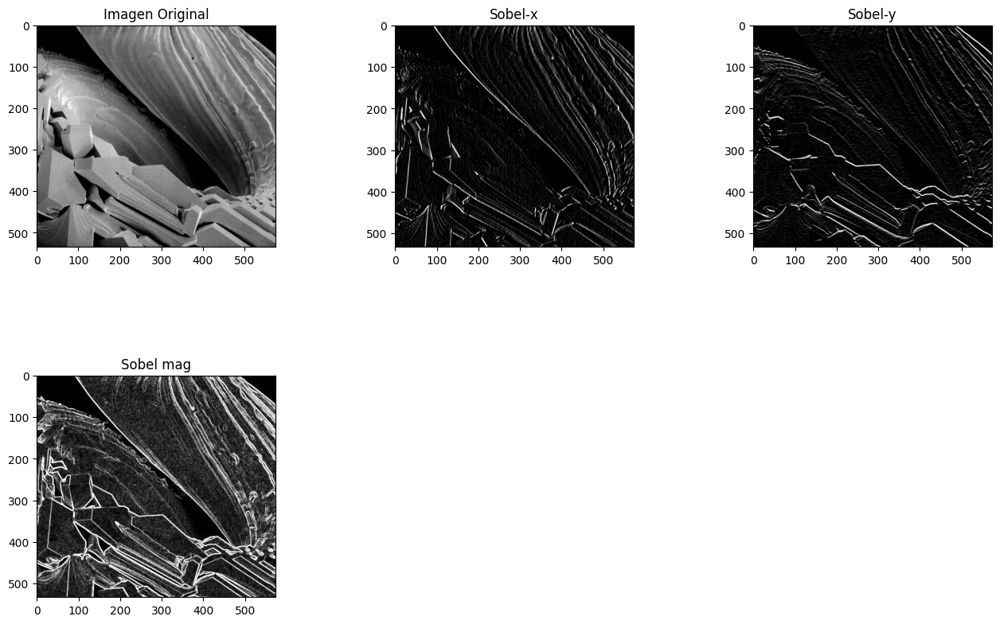

In [111]:
show_comparacion_filtros_3('Imagen Original','Sobel-x','Sobel-y','Sobel mag',
                           img2,img_sobel_1,img_sobel_2,img_sobel_3)

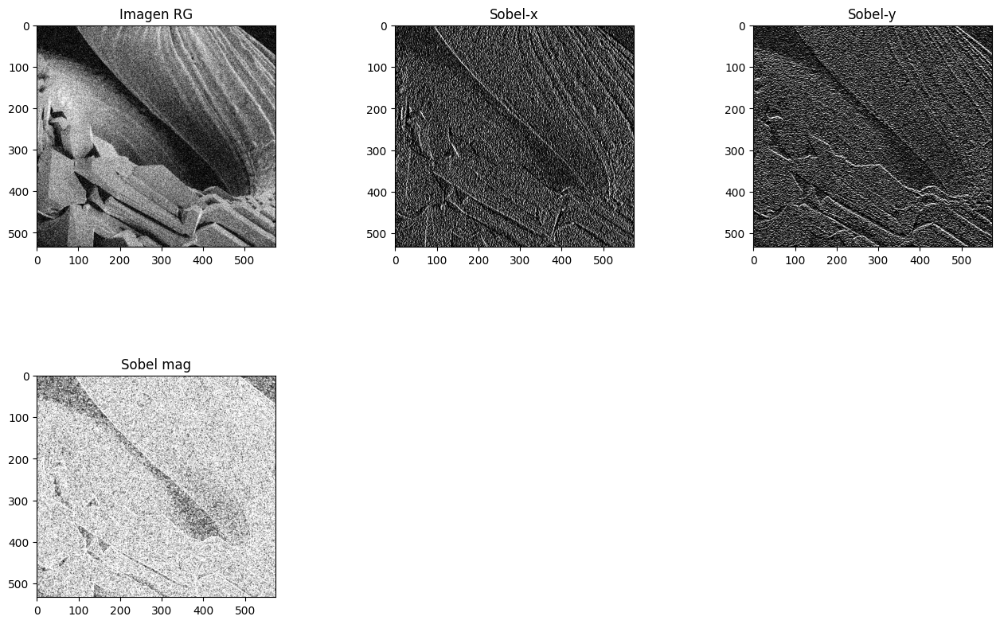

In [109]:
show_comparacion_filtros_3('Imagen RG','Sobel-x','Sobel-y','Sobel mag',
                           img_ruidoG2,img_sobel_5,img_sobel_6,img_sobel_7)

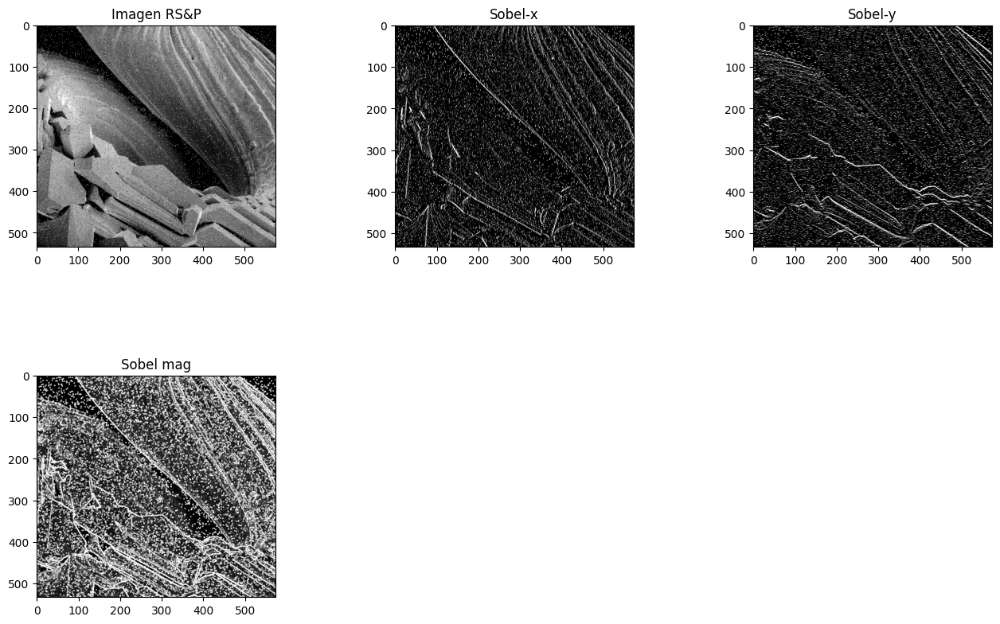

In [110]:
show_comparacion_filtros_3('Imagen RS&P','Sobel-x','Sobel-y','Sobel mag',
                           img_ruidoSP2,img_sobel_9,img_sobel_10,img_sobel_11)

## Filtro paso-altas Prewitt

In [49]:
def prewitt_x_y(image,direccion) :
 direcciones_Disponibles = ['x','y']
 try :  
    if isinstance(image, Image.Image):
      if image.mode == "L"  and (direccion in direcciones_Disponibles) and isinstance(image, Image.Image):
        ancho, alto = image.size
        anchoN = ancho-2
        altoN = alto-2
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            x_Aux = x
            y_Aux = y
            original_x = x_Aux + 1
            original_y = y_Aux + 1
            vecinos = vecindad_3x3(original_x,original_y)
            if direccion == 'x' :
                suma = prewitt_x_convolucion(vecinos,image)
            elif direccion == 'y' :
                suma = prewitt_y_convolucion(vecinos,image)
            imageN.putpixel((x, y), int(suma))
        return imageN
      else :
            print("Se solicita una imagen en escala de grises")  
            print("Se solicita una dirección valida de x o y")
    else :
        raise ValueError("Se solicita un imagen de objeto tipo PIL") 
 except ValueError as e:
          print(f"Error: {e}")

In [50]:
def prewitt_x_convolucion(vecinos,image) :
    kernel_horizontal = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_horizontal[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [51]:
def prewitt_y_convolucion(vecinos,image) :
    kernel_vertical = np.array([[1, 0, -1], [1, 0, -1], [1, 0, -1]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_vertical[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [52]:
def prewitt(image) :
 try :    
    if isinstance(image, Image.Image) :
      if image.mode == "L" :
        ancho, alto = image.size
        anchoN = ancho-2
        altoN = alto-2
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            x_Aux = x
            y_Aux = y
            original_x = x_Aux + 1
            original_y = y_Aux + 1
            vecinos = vecindad_3x3(original_x,original_y)
            suma = prewitt_x_convolucion(vecinos,image)
            suma2 = prewitt_y_convolucion(vecinos,image)
            magnitud = abs(suma) + abs(suma2)
            #magnitud = np.sqrt(suma**2 + suma2**2).astype(np.uint8)
            imageN.putpixel((x, y), int(magnitud))
        return imageN
      else :
        print("Se solicita una imagen en escala de grises")  
    else :
      raise ValueError("Se solicita un imagen de objeto tipo PIL")
 except ValueError as e:
          print(f"Error: {e}")

In [30]:
## Imagen Original
img_prewitt_1 = prewitt_x_y(img2,'x')
img_prewitt_2 = prewitt_x_y(img2,'y')
img_prewitt_3 = prewitt(img2)
img_prewitt_4 = suma_imagenes(img2,img_prewitt_3)

In [22]:
## Imagen RG
img_prewitt_5 = prewitt_x_y(img_ruidoG2,'x')
img_prewitt_6 = prewitt_x_y(img_ruidoG2,'y')
img_prewitt_7 = prewitt(img_ruidoG2)
img_prewitt_8 = suma_imagenes(img_ruidoG2,img_prewitt_7)

In [23]:
## Imagen RS&P
img_prewitt_9 = prewitt_x_y(img_ruidoSP2,'x')
img_prewitt_10 = prewitt_x_y(img_ruidoSP2,'y')
img_prewitt_11 = prewitt(img_ruidoSP2)
img_prewitt_12 = suma_imagenes(img_ruidoSP2,img_prewitt_11)

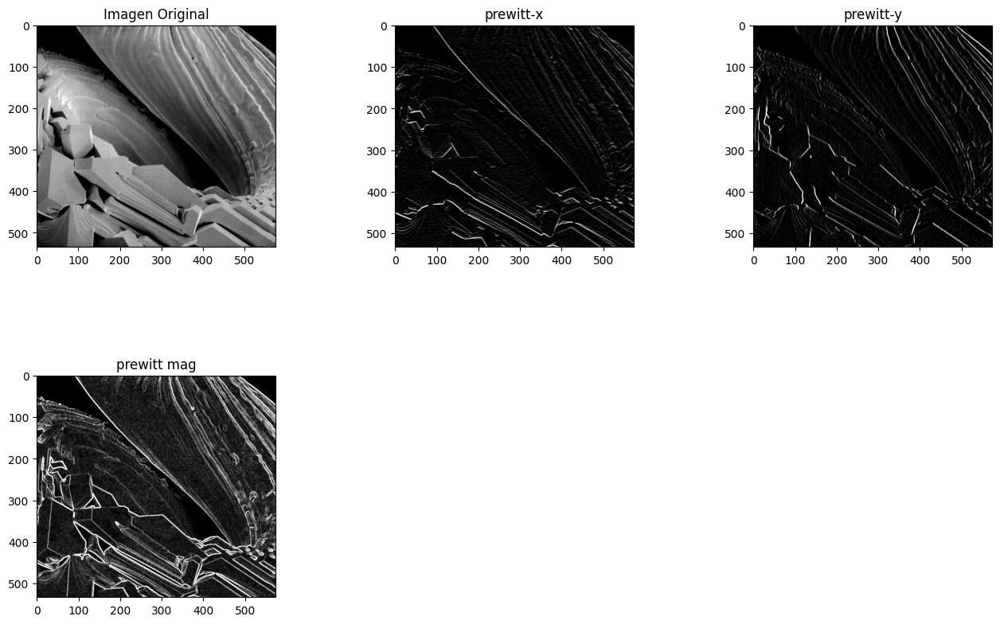

In [31]:
show_comparacion_filtros_3('Imagen Original','prewitt-x','prewitt-y','prewitt mag',
                           img2,img_prewitt_1,img_prewitt_2,img_prewitt_3)

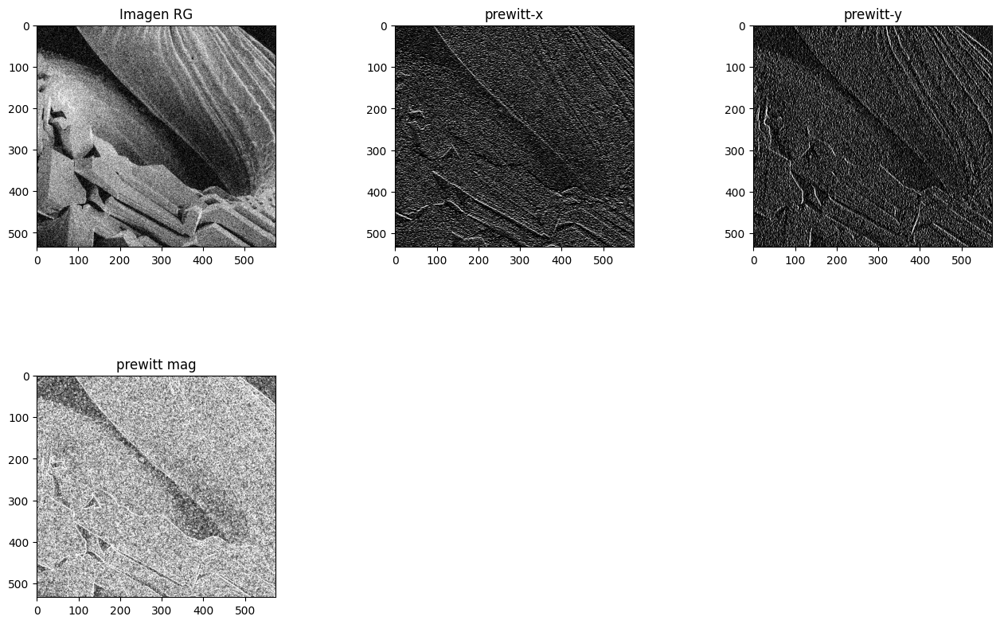

In [28]:
show_comparacion_filtros_3('Imagen RG','prewitt-x','prewitt-y','prewitt mag',
                           img_ruidoG2,img_prewitt_5,img_prewitt_6,img_prewitt_7)

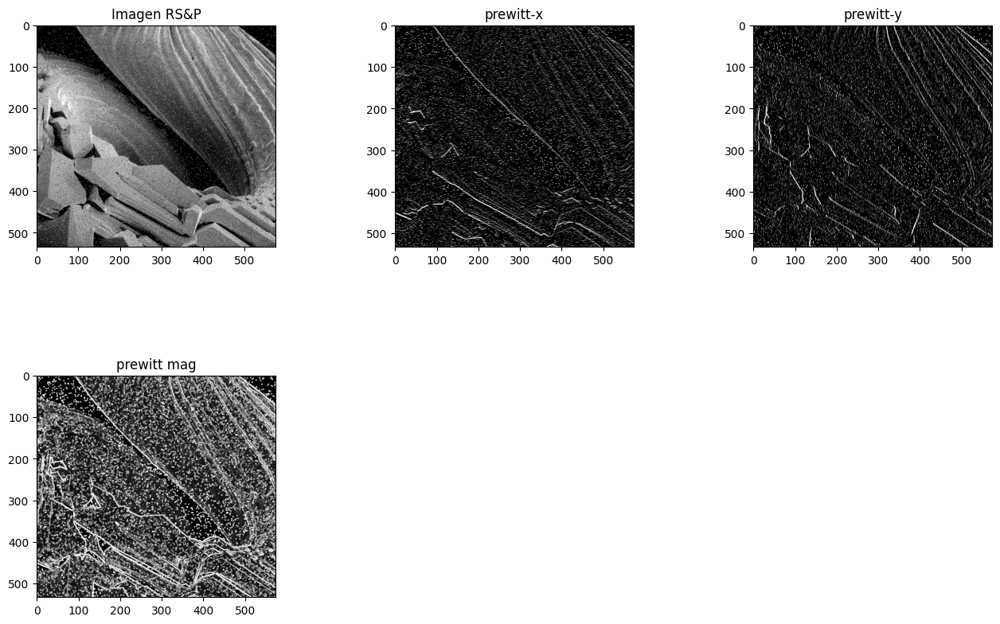

In [29]:
show_comparacion_filtros_3('Imagen RS&P','prewitt-x','prewitt-y','prewitt mag',
                           img_ruidoSP2,img_prewitt_9,img_prewitt_10,img_prewitt_11)

## Filtro paso-altas Laplaciano 45°

In [53]:
def convolucion_45_compuesta(vecinos,image) :
    kernel_45 = np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_45[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [54]:
def convolucion_45(vecinos,image) :
    kernel_45 = np.array([[-1, -1, -1], [-1, 8, -1], [-1, -1, -1]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_45[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [55]:
def laplaciano_45(image,metodo) :
 metodo_Disponible = ['c','i']
 try : 
    if  isinstance(image, Image.Image):
      if image.mode == "L"  and (orden in metodo_Disponible):
        ancho, alto = image.size
        anchoN = ancho-2
        altoN = alto-2
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            vecinos = vecindad_3x3(x+1,y+1)
            if metodo == 'c' :
                 suma = convolucion_45_compuesta(vecinos,image)
            elif metodo == 'i' :
                suma = convolucion_45(vecinos,image)
            imageN.putpixel((x, y), int(suma))
        return imageN
      else :
            print("Se solicita una imagen en escala de grises")  
            print("Se solicita método válido de c o i")
            print("Se solicita un imagen de objeto tipo PIL")
    else : 
        raise ValueError("Se solicita un imagen de objeto tipo PIL")
 except ValueError as e:
          print(f"Error: {e}")

In [197]:
## Imagen
img_45_1 = laplaciano_45(img2,'c')
img_45_2 = laplaciano_45(img2,'i')
#resta_imagenes(img2,img_45_1)what the rest of the images look like

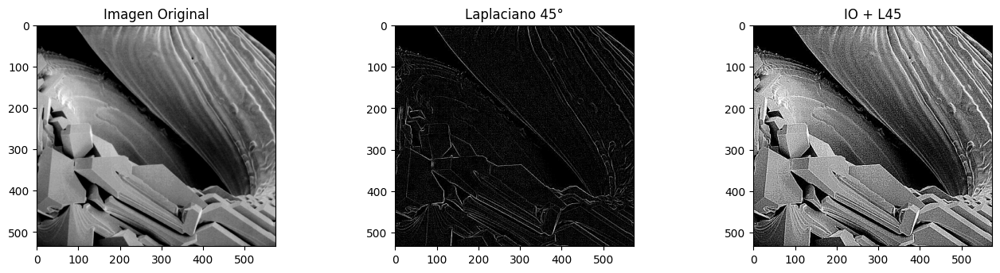

In [62]:
show_comparacion_filtros_4('Imagen Original','Laplaciano 45°','IO + L45',img2,img_45_2,img_45_1)

## Filtro pasa altas Laplaciano 90 °

In [56]:
def convolucion_90_compuesta(vecinos,image) :
    kernel_90 = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_90[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [57]:
def convolucion_90(vecinos,image) :
    kernel_90 = np.array([[0, -1, 0], [-1, 4, -1], [0, -1, 0]])
    filtro_size = [0,1,2]
    i = 0
    suma = 0
    for x in filtro_size :
        for y in filtro_size :
            valor = kernel_90[x][y]
            valor2 = image.getpixel(vecinos[i])
            i = i + 1
            pixel_valor = valor * valor2
            suma = suma + pixel_valor
    return suma

In [58]:
def laplaciano_90(image,metodo) :
 metodo_Disponible = ['c','i']
 try :    
  if  isinstance(image, Image.Image):
      if image.mode == "L"  and (metodo in metodo_Disponible) :
        ancho, alto = image.size
        anchoN = ancho-2
        altoN = alto-2
        imageN = Image.new("L", (anchoN, altoN))
        for x in range(anchoN) :
         for y in range (altoN) :
            vecinos = vecindad_3x3(x+1,y+1)
            if metodo == 'c' :
                suma = convolucion_90_compuesta(vecinos,image)
            elif metodo == 'i' : 
              suma = convolucion_90(vecinos,image)
            imageN.putpixel((x, y), int(suma))
        return imageN
      else :
        print("Se solicita una imagen en escala de grises")  
        print("Se solicita un método válido de c o i ")
  else :
      raise ValueError("Se solicita un imagen de objeto tipo PIL")
 except ValueError as e:
          print(f"Error: {e}")

In [231]:
img_90_1 = laplaciano_90(img2,'c')
img_90_2 = laplaciano_90(img2,'i')

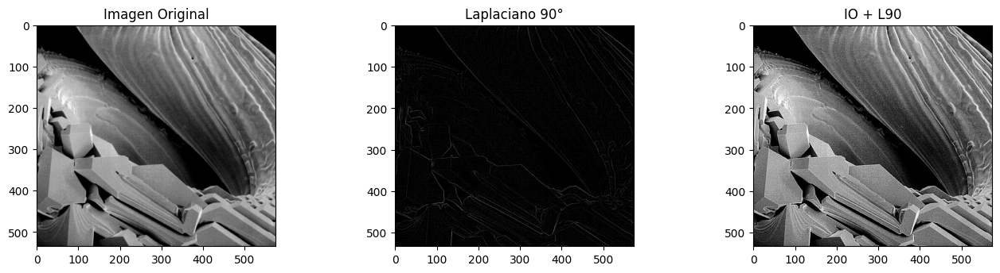

In [68]:
show_comparacion_filtros_4('Imagen Original','Laplaciano 90°','IO + L90',img2,img_90_2,img_90_1)

In [59]:
def mask_unsharping(img_original,img_emborronada) :
 try : 
   if  isinstance(img_original, Image.Image) and isinstance(img_emborronada, Image.Image) :
      if img_original.mode == "L" and img_emborronada.mode == "L":
        resultado =  resta_imagenes_2(img_original,img_emborronada)
        #n,m = img_emborronada.size
        #img_original_re = img_original.resize((n, m))
        #arreglo = np.zeros((m, n), dtype=np.uint8)
        #for x in range(n):
         #for y in range(m):
            #pixel_original = img_original_re.getpixel((x, y))
            #pixel_suavizada = img_emborronada.getpixel((x, y))
            #diferencia = pixel_original - pixel_suavizada
            #diferencia_2 = max(0, min(255, diferencia))
            #arreglo[x][y] = diferencia
            #resultado.putpixel((x, y), diferencia_2)
        return resultado
      else :
            print("Se solicita una imagen en escala de grises")  
   else :
      raise ValueError("Se solicita un imagen de objeto tipo PIL")
 except ValueError as e:
          print(f"Error: {e}")

In [58]:
#img_pbp_ponderado_2 -- Original  5x5
#img_pbp_ponderado_6 --- RG 5x5
#img_pbp_ponderado_10 -- S&P 5x5
filtro_pbp_ponderado_1_1 = filtro_pbp_ponderado(3,img2)
filtro_pbp_ponderado_2_2 = filtro_pbp_ponderado(7,img2)
filtro_pbp_estandar_3_3 = filtro_pbp_estandar(3,img2)
filtro_pbp_estandar_4_4 = filtro_pbp_estandar(7,img2)

In [59]:
#img_pbp_ponderado_2 -- Original  5x5
#img_pbp_ponderado_6 --- RG 5x5
#img_pbp_ponderado_10 -- S&P 5x5
filtro_pbp_ponderado_1 = filtro_pbp_ponderado(3,img_pbp_ponderado_2)
filtro_pbp_ponderado_2 = filtro_pbp_ponderado(3,img_pbp_ponderado_6)
filtro_pbp_ponderado_3 = filtro_pbp_ponderado(3,img_pbp_ponderado_10)

In [60]:
filtro_pbp_ponderado_4 = filtro_pbp_ponderado(7,img_pbp_ponderado_2)
filtro_pbp_ponderado_5 = filtro_pbp_ponderado(7,img_pbp_ponderado_6)
filtro_pbp_ponderado_6 = filtro_pbp_ponderado(7,img_pbp_ponderado_10)

In [61]:
filtro_pbp_estandar_1 = filtro_pbp_estandar(3,img_pbp_ponderado_2)
filtro_pbp_estandar_2 = filtro_pbp_estandar(3,img_pbp_ponderado_6)
filtro_pbp_estandar_3 = filtro_pbp_estandar(3,img_pbp_ponderado_10)

In [62]:
filtro_pbp_estandar_4 = filtro_pbp_estandar(7,img_pbp_ponderado_2)
filtro_pbp_estandar_5 = filtro_pbp_estandar(7,img_pbp_ponderado_6)
filtro_pbp_estandar_6 = filtro_pbp_estandar(7,img_pbp_ponderado_10)

In [65]:
img_MaskUnsharp_1 = mask_unsharping(img_pbp_ponderado_2,filtro_pbp_ponderado_1)
img_MaskUnsharp_2 = mask_unsharping(img_pbp_ponderado_2,filtro_pbp_ponderado_4)
img_MaskUnsharp_3 = mask_unsharping(img_pbp_ponderado_2,filtro_pbp_estandar_1)
img_MaskUnsharp_4 = mask_unsharping(img_pbp_ponderado_2,filtro_pbp_estandar_4)

In [66]:
img_MaskUnsharp_5 = mask_unsharping(img_pbp_ponderado_6,filtro_pbp_ponderado_2)
img_MaskUnsharp_6 = mask_unsharping(img_pbp_ponderado_6,filtro_pbp_ponderado_5)
img_MaskUnsharp_7 = mask_unsharping(img_pbp_ponderado_6,filtro_pbp_estandar_2)
img_MaskUnsharp_8 = mask_unsharping(img_pbp_ponderado_6,filtro_pbp_estandar_5)

In [67]:
img_MaskUnsharp_9 = mask_unsharping(img_pbp_ponderado_10,filtro_pbp_ponderado_3)
img_MaskUnsharp_10 = mask_unsharping(img_pbp_ponderado_10,filtro_pbp_ponderado_6)
img_MaskUnsharp_11 = mask_unsharping(img_pbp_ponderado_10,filtro_pbp_estandar_3)
img_MaskUnsharp_12 = mask_unsharping(img_pbp_ponderado_10,filtro_pbp_estandar_6)

In [68]:
img_MaskUnsharp_13 = mask_unsharping(img2,filtro_pbp_ponderado_1_1)
img_MaskUnsharp_14 = mask_unsharping(img2,filtro_pbp_ponderado_2_2)
img_MaskUnsharp_15 = mask_unsharping(img2,filtro_pbp_estandar_3_3)
img_MaskUnsharp_16 = mask_unsharping(img2,filtro_pbp_estandar_4_4)

In [69]:
suma_13 = suma_imagenes(img2,img_MaskUnsharp_13)
suma_14 = suma_imagenes(img2,img_MaskUnsharp_14)
suma_15 = suma_imagenes(img2,img_MaskUnsharp_15)
suma_16 = suma_imagenes(img2,img_MaskUnsharp_16)

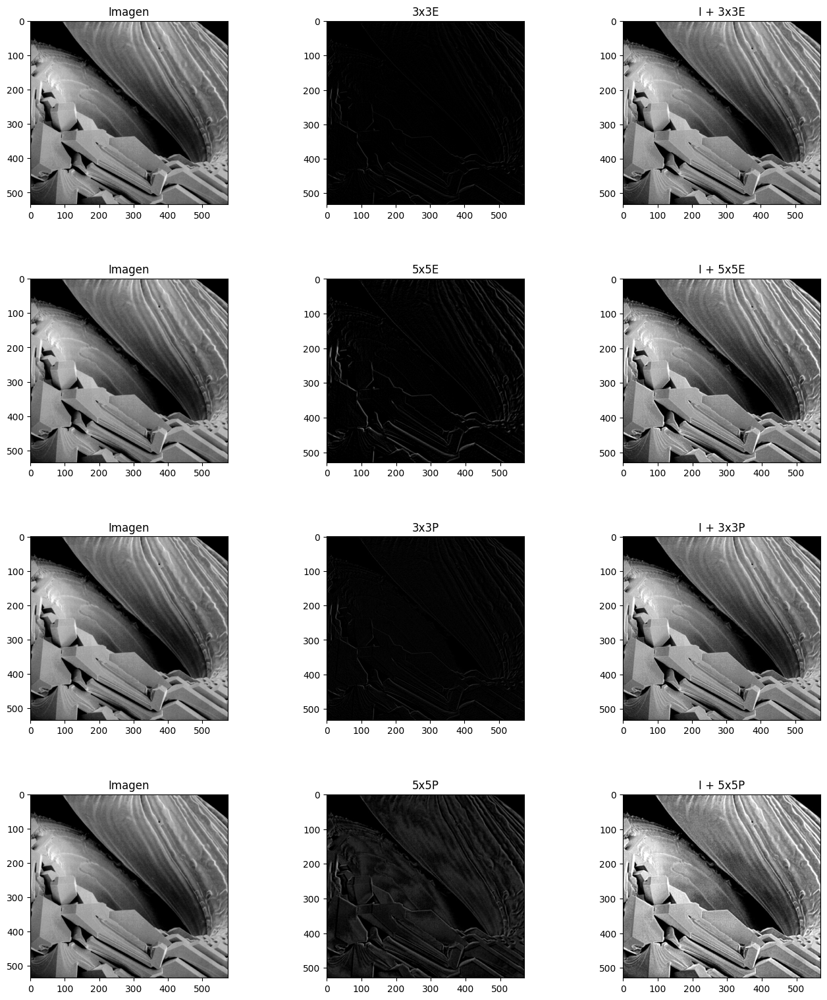

In [76]:
show_comparacion_filtros_3_1('Imagen','3x3E','I + 3x3E','Imagen','5x5E','I + 5x5E','Imagen','3x3P','I + 3x3P'
                             ,'Imagen','5x5P','I + 5x5P',
                           img2,img_MaskUnsharp_13,suma_13 ,
                           img2,img_MaskUnsharp_14,suma_14,  
                           img2,img_MaskUnsharp_15,suma_15,
                           img2,img_MaskUnsharp_16,suma_16)

In [70]:
suma_1 = suma_imagenes(img_pbp_ponderado_2,img_MaskUnsharp_1)
suma_2 = suma_imagenes(img_pbp_ponderado_2,img_MaskUnsharp_2)
suma_3 = suma_imagenes(img_pbp_ponderado_2,img_MaskUnsharp_3)
suma_4 = suma_imagenes(img_pbp_ponderado_2,img_MaskUnsharp_4)

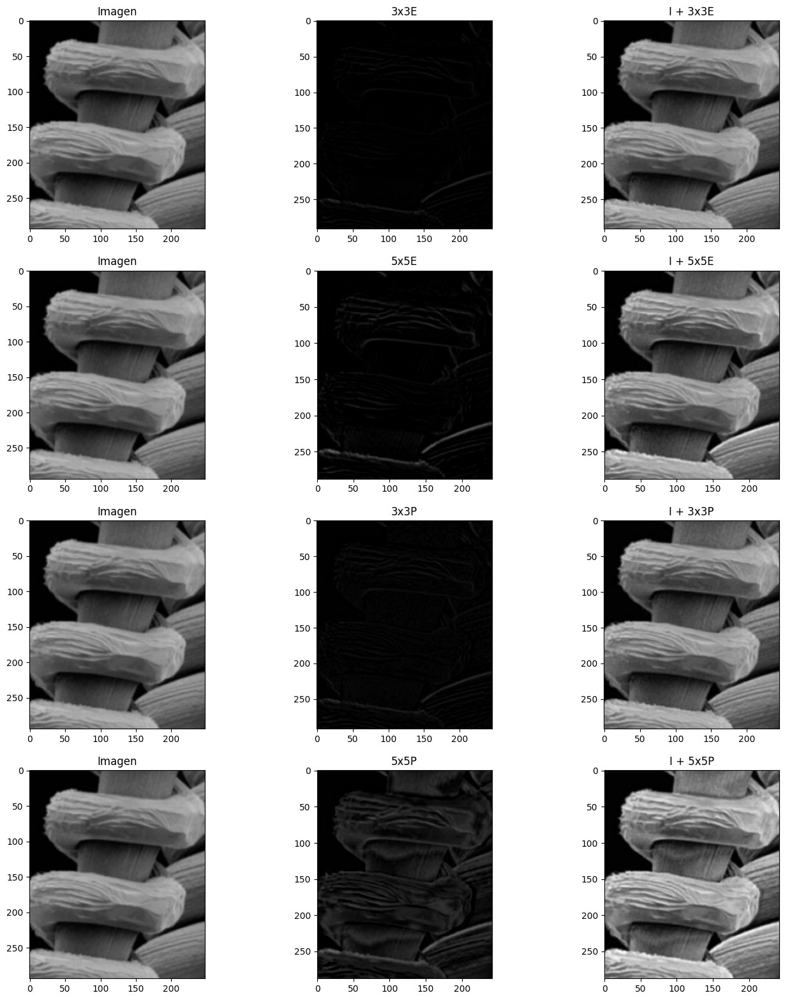

In [71]:
show_comparacion_filtros_3_1('Imagen','3x3E','I + 3x3E','Imagen','5x5E','I + 5x5E','Imagen','3x3P','I + 3x3P'
                             ,'Imagen','5x5P','I + 5x5P',
                           img_pbp_ponderado_2,img_MaskUnsharp_1,suma_1 ,
                           img_pbp_ponderado_2,img_MaskUnsharp_2,suma_2,  
                           img_pbp_ponderado_2,img_MaskUnsharp_3,suma_3,
                           img_pbp_ponderado_2,img_MaskUnsharp_4,suma_4)

In [72]:
suma_5 = suma_imagenes(img_pbp_ponderado_6,img_MaskUnsharp_5)
suma_6 = suma_imagenes(img_pbp_ponderado_6,img_MaskUnsharp_6)
suma_7 = suma_imagenes(img_pbp_ponderado_6,img_MaskUnsharp_7)
suma_8 = suma_imagenes(img_pbp_ponderado_6,img_MaskUnsharp_8)

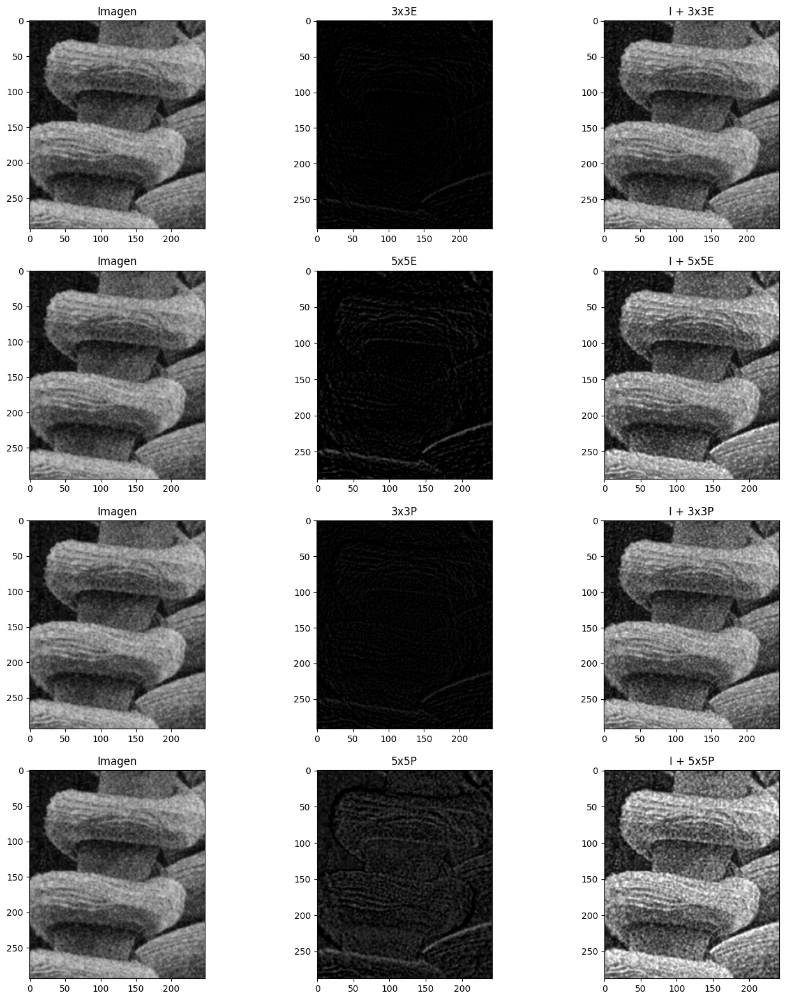

In [73]:
show_comparacion_filtros_3_1('Imagen','3x3E','I + 3x3E','Imagen','5x5E','I + 5x5E','Imagen','3x3P','I + 3x3P'
                             ,'Imagen','5x5P','I + 5x5P',
                           img_pbp_ponderado_6,img_MaskUnsharp_5,suma_5 ,
                           img_pbp_ponderado_6,img_MaskUnsharp_6,suma_6,  
                           img_pbp_ponderado_6,img_MaskUnsharp_7,suma_7,
                           img_pbp_ponderado_6,img_MaskUnsharp_8,suma_8)

In [74]:
suma_9 = suma_imagenes(img_pbp_ponderado_10,img_MaskUnsharp_9)
suma_10 = suma_imagenes(img_pbp_ponderado_10,img_MaskUnsharp_10)
suma_11 = suma_imagenes(img_pbp_ponderado_10,img_MaskUnsharp_11)
suma_12 = suma_imagenes(img_pbp_ponderado_10,img_MaskUnsharp_12)

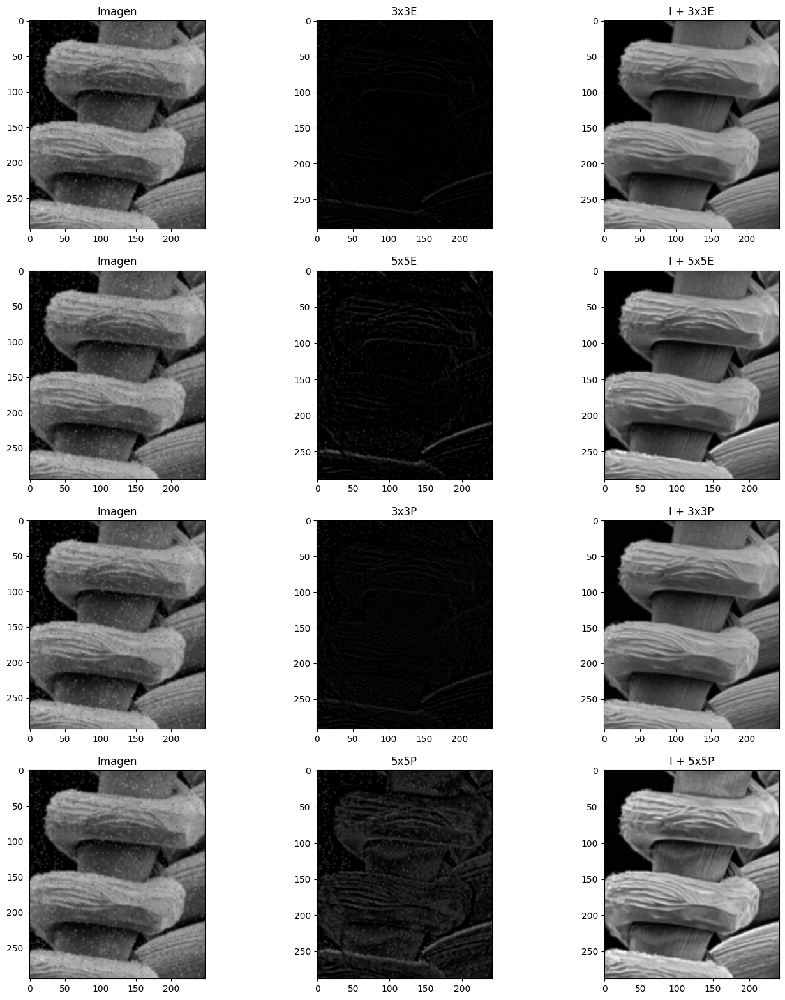

In [75]:
show_comparacion_filtros_3_1('Imagen','3x3E','I + 3x3E','Imagen','5x5E','I + 5x5E','Imagen','3x3P','I + 3x3P'
                             ,'Imagen','5x5P','I + 5x5P',
                           img_pbp_ponderado_10,img_MaskUnsharp_9,suma_1 ,
                           img_pbp_ponderado_10,img_MaskUnsharp_10,suma_2,  
                           img_pbp_ponderado_10,img_MaskUnsharp_11,suma_3,
                           img_pbp_ponderado_10,img_MaskUnsharp_12,suma_4)